# November ??th, 2021 (corr distributions)

**Motivation**: Visualizing distribution of correlations and discussing different sparsification approaches <br>

In [1]:
# HIDE CODE


import os
import sys
import nibabel as nib
import networkx as nx
from time import time
from pprint import pprint
from copy import deepcopy as dc
from os.path import join as pjoin
from myterial import orange, blue_grey
from IPython.display import display, IFrame, HTML
from matplotlib.colors import rgb2hex, to_rgb
import matplotlib.pyplot as plt
import seaborn as sns

# set style & no interpolalation
import matplotlib
matplotlib.rcParams['image.interpolation'] = 'none'
sns.set_style('whitegrid')
%matplotlib inline

# tmp & extras dir
git_dir = pjoin(os.environ['HOME'], 'Dropbox/git')
tmp_dir = pjoin(git_dir, 'jb-Ca-fMRI/tmp')
extras_dir = pjoin(git_dir, 'jb-Ca-fMRI/_extras')
lfr_dir = pjoin(os.environ['HOME'], 'Documents/workspaces/lfr/binary_overlapping')


# GitHub
sys.path.insert(0, pjoin(git_dir, '_Ca-fMRI'))
from register.atlas import make_tree_graph
from register.parcellation import Parcellation
from analysis.hierarchical import Hierarchical
from analysis.fourier import *
from analysis.bootstrap import *
from analysis.svinet import *
from analysis.group import *
from analysis.lfr import *
from utils.render import *
from utils.plotting import *
from model.mouse import Mice
from model.configuration import Config

# warnings
import warnings
warnings.filterwarnings('ignore', category=DeprecationWarning)

In [2]:
# HIDE CODE


def show_corrs(key):
    try:
        net_ca = Network(mice, key, 'ca2').load_network()
        net_bold = Network(mice, key, 'bold-lite').load_network()
    except TypeError:
        return 
    
    fig, axes = create_figure(2, 4, (12.8, 6))

    for i, _net in enumerate([net_bold, net_ca]):
        xl = _net.adj[_net.l_ids][:, _net.l_ids]
        xr = _net.adj[_net.r_ids][:, _net.r_ids]
        vmin = np.min(_net.adj)
        vmax = np.max(_net.adj)

        j = 2 * i
        im = axes[0, j].imshow(xl, vmin=vmin, vmax=vmax, cmap='Spectral_r')
        plt.colorbar(im, ax=axes[0, j], shrink=0.75)
        axes[0, j].set_title(f"{_net.mode} (left hemis)")

        j = 2 * i + 1
        im = axes[0, j].imshow(xr, vmin=vmin, vmax=vmax, cmap='Spectral_r')
        plt.colorbar(im, ax=axes[0, j], shrink=0.75)
        axes[0, j].set_title(f"{_net.mode} (right hemis)")

        j = 2 * i
        sns.histplot(
            data=xl[xl.nonzero()],
            label='left hemis',
            stat='percent',
            color='C0',
            bins=30,
            alpha=0.7,
            ax=axes[1, j],
        )
        sns.histplot(
            data=xr[xr.nonzero()],
            label='right hemis',
            stat='percent',
            color='C3',
            bins=30,
            alpha=0.7,
            ax=axes[1, j],
        )
        axes[1, j].set_xlabel('correlation')
        axes[1, j].set_title(f"{_net.mode} corr hist")
        axes[1, j].legend()

        j = 2 * i + 1
        sns.ecdfplot(
            data=xl[xl.nonzero()],
            label='left hemis',
            color='C0',
            lw=2,
            ax=axes[1, j],
        )
        sns.ecdfplot(
            data=xr[xr.nonzero()],
            label='right hemis',
            color='C3',
            lw=2,
            ax=axes[1, j],
        )
        axes[1, j].set_xlabel('correlation')
        axes[1, j].set_title(f"{_net.mode} corr ecdf")
        axes[1, j].legend()
        axes[1, j].grid()
    fig.suptitle(key, fontsize=15, y=1.03)
    plt.show()
    
    return (net_ca, net_bold), (fig, axes)

In [3]:
mice = Mice((192, 4))

In [27]:
in_house = '/home/hadi/Documents/Ca-fMRI/Yale/atlases_templates'
in_house = pjoin(in_house, 'Symmetric_N162_0.20.nii.gz')
in_house = ants.image_read(in_house)
mask = in_house.get_mask().numpy().astype(bool)

in_house

ANTsImage (RAI)
         Pixel Type : float (float32)
         Components : 1
         Dimensions : (60, 46, 81)
         Spacing    : (0.2, 0.2, 0.2)
         Origin     : (6.4, -6.2, -7.8)
         Direction  : [1. 0. 0. 0. 1. 0. 0. 0. 1.]

In [28]:
m_l = np.zeros_like(mask)
m_r = np.zeros_like(mask)
m_l[:30] = 1
m_r[30:] = 1

m_l *= mask
m_r *= mask

In [29]:
id2vox = {i + 1: vox for i, vox in enumerate(zip(*np.where(mask)))}
vox2id = {vox: idx for idx, vox in id2vox.items()}

voxels_l = [vox2id[vox] for vox in zip(*np.where(m_l))]
voxels_r = [vox2id[vox] for vox in zip(*np.where(m_r))]

l_ids = np.where(np.isin(list(id2vox), voxels_l))[0]
r_ids = np.where(np.isin(list(id2vox), voxels_r))[0]
assert not set(l_ids).intersection(r_ids)

len(id2vox), len(voxels_l), len(voxels_r), len(l_ids), len(r_ids)

(53520, 26760, 26760, 26760, 26760)

In [30]:
cortex = 'Symmetric_N162_space-indiv3d_cortex.nii.gz'
cortex = pjoin(mice.cfg.masks_dir, cortex)
cortex = ants.image_read(cortex, pixeltype='unsigned int')
cortex = cortex.numpy()

<matplotlib.image.AxesImage object at 0x7f10dd666910>

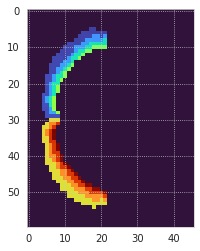

In [39]:
mask_tr, in_house_tr, cortex_tr = filter_boundaries([mask, in_house.numpy(), cortex], mask)

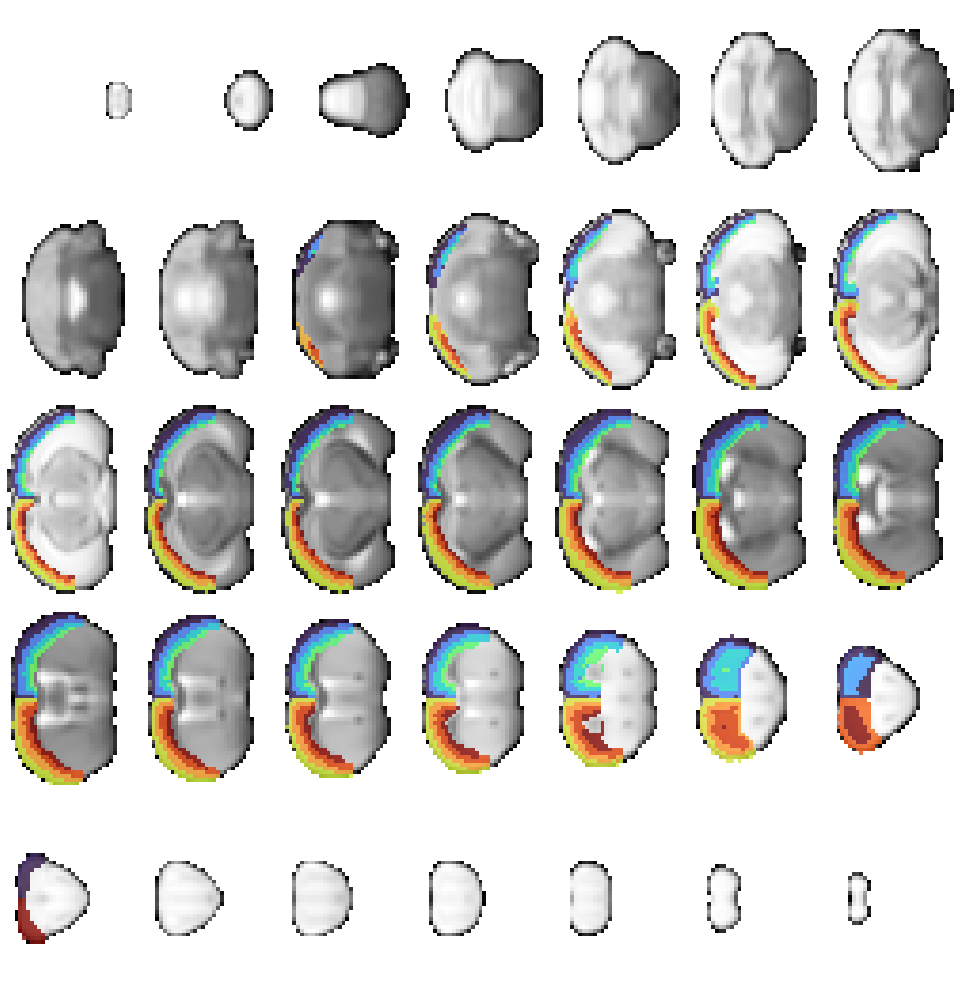

In [59]:
fig, axes = create_figure(5, 7, (13.5, 14))

for i, idx in enumerate(range(1, mask_tr.shape[-1], 2)):
    ax = axes.ravel()[i]

    x2plt = np.ma.masked_where(~mask_tr[..., idx], in_house_tr[..., idx])
    ax.imshow(x2plt, cmap='Greys_r')

    x2plt = np.ma.masked_where(cortex_tr[..., idx] == 0, cortex_tr[..., idx])
    ax.imshow(x2plt, alpha=0.8, cmap='turbo')

remove_ticks(axes)
plt.show()

In [64]:
roi_masks = {
    idx: cortex == idx for idx in
    np.unique(cortex[cortex.nonzero()])
}

In [91]:
key = 'sub-SLC02_ses-3_run-5'
file = next(
    f for f in os.listdir(mice.cfg.npy_dir)
    if all(e in f for e in [key, 'N162'])
)
x = np.load(pjoin(mice.cfg.npy_dir, file))
x.shape

(60, 46, 81, 600)

In [93]:
data = {
    idx: x[np.logical_and(m,  mask)]
    for idx, m in roi_masks.items()
}
len(data)

1401

In [96]:
{k: v.shape for k, v in data.items()}

{
    1: (5, 600),
    2: (9, 600),
    3: (7, 600),
    4: (24, 600),
    5: (3, 600),
    6: (10, 600),
    7: (7, 600),
    8: (7, 600),
    9: (14, 600),
    10: (6, 600),
    11: (8, 600),
    12: (9, 600),
    13: (3, 600),
    14: (8, 600),
    15: (10, 600),
    16: (8, 600),
    17: (3, 600),
    18: (4, 600),
    19: (6, 600),
    20: (12, 600),
    21: (11, 600),
    22: (11, 600),
    23: (9, 600),
    24: (10, 600),
    25: (3, 600),
    26: (4, 600),
    27: (8, 600),
    28: (9, 600),
    29: (11, 600),
    30: (13, 600),
    31: (12, 600),
    32: (11, 600),
    33: (12, 600),
    34: (4, 600),
    35: (10, 600),
    36: (6, 600),
    37: (8, 600),
    38: (13, 600),
    39: (12, 600),
    40: (10, 600),
    41: (13, 600),
    42: (3, 600),
    43: (15, 600),
    44: (4, 600),
    45: (16, 600),
    46: (13, 600),
    47: (4, 600),
    48: (13, 600),
    49: (6, 600),
    50: (17, 600),
    51: (7, 600),
    52: (18, 600),
    53: (8, 600),
    54: (6, 600),
    55: (16, 600),
    56: (19, 600),
    57: (8, 600),
    58: (12, 600),
    59: (2, 600),
    60: (8, 600),
    61: (7, 600),
    62: (15, 600),
    63: (19, 600),
    64: (15, 600),
    65: (10, 600),
    66: (18, 600),
    67: (9, 600),
    68: (16, 600),
    69: (11, 600),
    70: (13, 600),
    71: (19, 600),
    72: (4, 600),
    73: (25, 600),
    74: (14, 600),
    75: (9, 600),
    76: (8, 600),
    77: (16, 600),
    78: (21, 600),
    79: (10, 600),
    80: (26, 600),
    81: (23, 600),
    82: (16, 600),
    83: (23, 600),
    84: (10, 600),
    85: (15, 600),
    86: (21, 600),
    87: (5, 600),
    88: (6, 600),
    89: (7, 600),
    90: (12, 600),
    91: (28, 600),
    92: (23, 600),
    93: (10, 600),
    94: (14, 600),
    95: (12, 600),
    96: (20, 600),
    97: (27, 600),
    98: (9, 600),
    99: (27, 600),
    100: (17, 600),
    101: (2, 600),
    102: (21, 600),
    103: (10, 600),
    104: (17, 600),
    105: (18, 600),
    106: (31, 600),
    107: (13, 600),
    108: (8, 600),
    109: (17, 600),
    110: (7, 600),
    111: (21, 600),
    112: (24, 600),
    113: (1, 600),
    114: (17, 600),
    115: (24, 600),
    116: (18, 600),
    117: (10, 600),
    118: (13, 600),
    119: (21, 600),
    120: (16, 600),
    121: (14, 600),
    122: (8, 600),
    123: (16, 600),
    124: (14, 600),
    125: (3, 600),
    126: (13, 600),
    127: (7, 600),
    128: (17, 600),
    129: (16, 600),
    130: (7, 600),
    131: (13, 600),
    132: (7, 600),
    133: (12, 600),
    134: (9, 600),
    135: (8, 600),
    136: (3, 600),
    137: (12, 600),
    138: (11, 600),
    139: (12, 600),
    140: (9, 600),
    141: (7, 600),
    142: (11, 600),
    143: (9, 600),
    144: (10, 600),
    145: (5, 600),
    146: (9, 600),
    147: (12, 600),
    148: (8, 600),
    149: (6, 600),
    150: (5, 600),
    151: (10, 600),
    152: (7, 600),
    153: (8, 600),
    154: (7, 600),
    155: (5, 600),
    156: (5, 600),
    157: (11, 600),
    159: (12, 600),
    160: (7, 600),
    161: (10, 600),
    162: (8, 600),
    163: (6, 600),
    164: (9, 600),
    165: (7, 600),
    166: (4, 600),
    167: (8, 600),
    168: (4, 600),
    169: (9, 600),
    170: (7, 600),
    171: (3, 600),
    172: (5, 600),
    173: (9, 600),
    174: (6, 600),
    175: (3, 600),
    176: (2, 600),
    177: (7, 600),
    178: (2, 600),
    179: (3, 600),
    180: (3, 600),
    181: (4, 600),
    182: (4, 600),
    183: (6, 600),
    184: (5, 600),
    185: (2, 600),
    186: (1, 600),
    187: (2, 600),
    188: (1, 600),
    189: (2, 600),
    190: (3, 600),
    191: (4, 600),
    193: (10, 600),
    194: (14, 600),
    195: (5, 600),
    196: (15, 600),
    197: (5, 600),
    198: (7, 600),
    199: (4, 600),
    200: (6, 600),
    201: (6, 600),
    202: (2, 600),
    203: (3, 600),
    204: (7, 600),
    205: (3, 600),
    206: (7, 600),
    207: (4, 600),
    208: (7, 600),
    209: (6, 600),
    210: (7, 600),
    211: (5, 600),
    212: (5, 600),
    213: (7, 600),
  

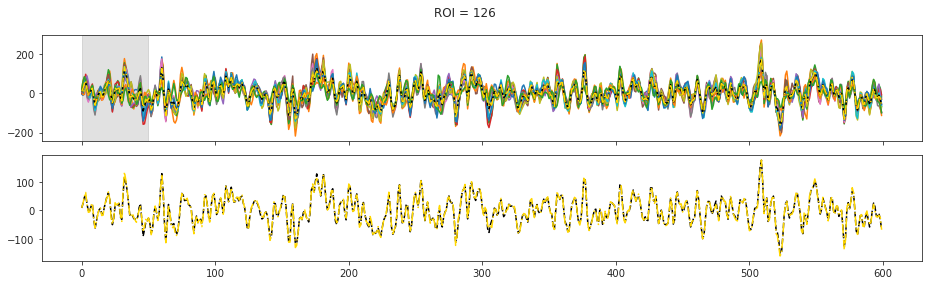

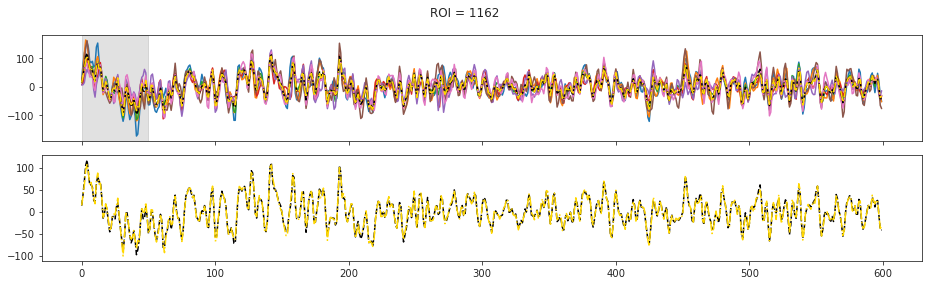

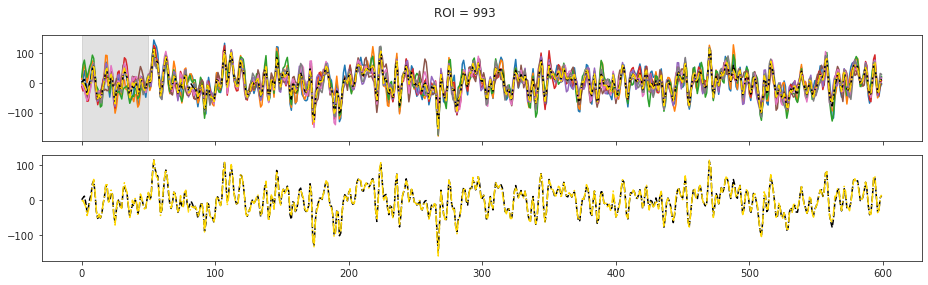

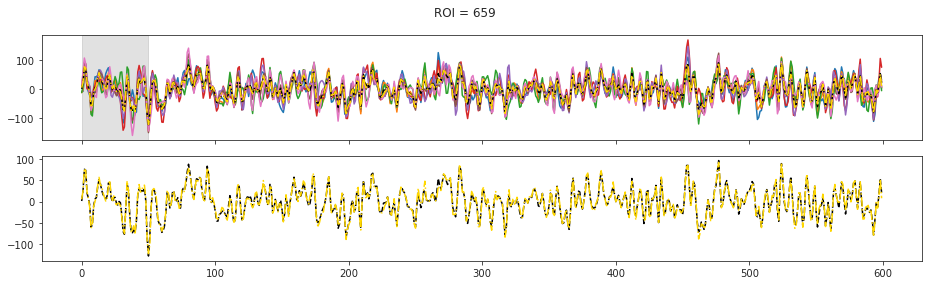

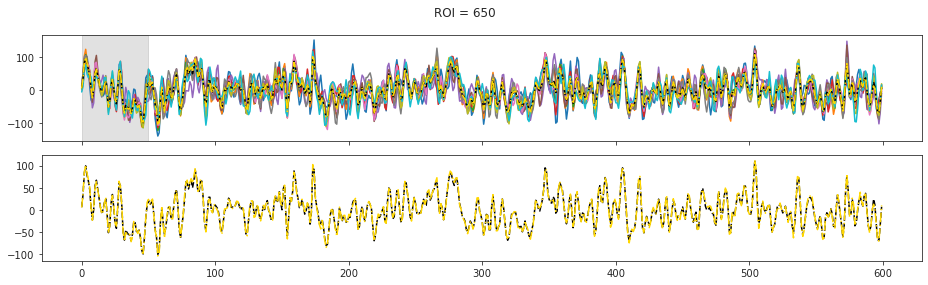

...

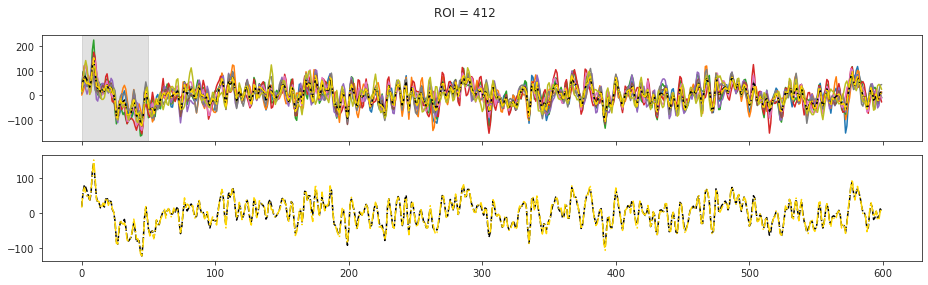

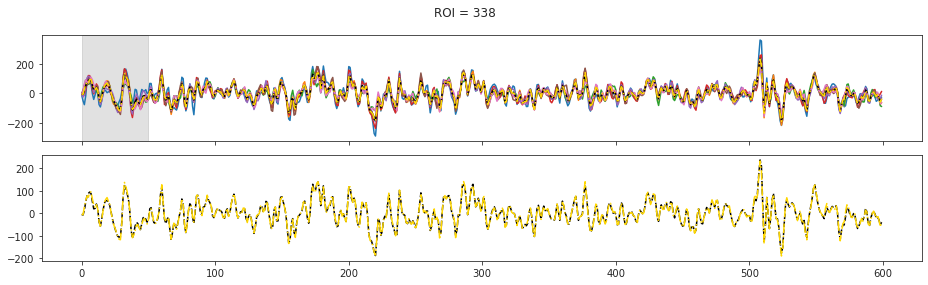

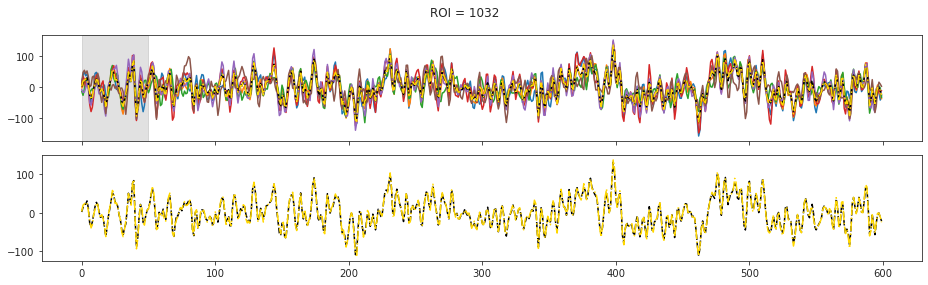

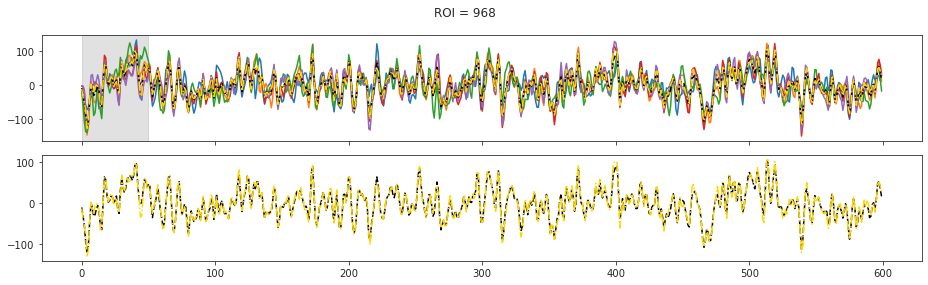

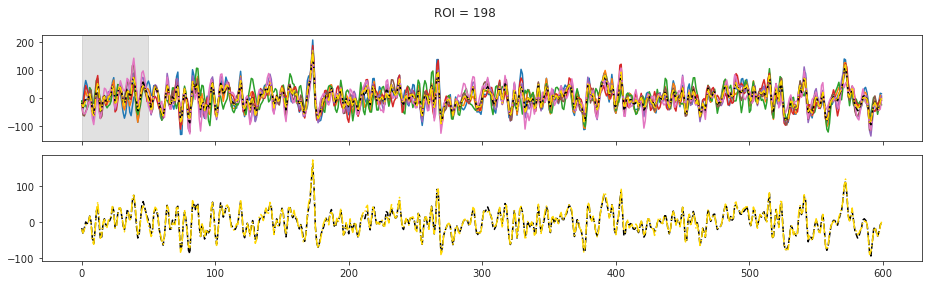

In [124]:
rng = get_rng()

for idx in rng.choice(list(data), size=100):
    fig, axes = create_figure(2, 1, (13, 4), 'all')
    axes[0].plot(data[idx].T)
    axes[0].plot(np.mean(data[idx], 0), color='k', ls='--')
    axes[0].plot(np.median(data[idx], 0), color='gold', ls='-.')
    axes[0].axvspan(0, 50, color='dimgrey', alpha=0.2)

    axes[1].plot(np.mean(data[idx], 0), color='k', ls='--')
    axes[1].plot(np.median(data[idx], 0), color='gold', ls='-.')

    fig.suptitle(f"ROI = {idx}")

    plt.show()
    print('\n')

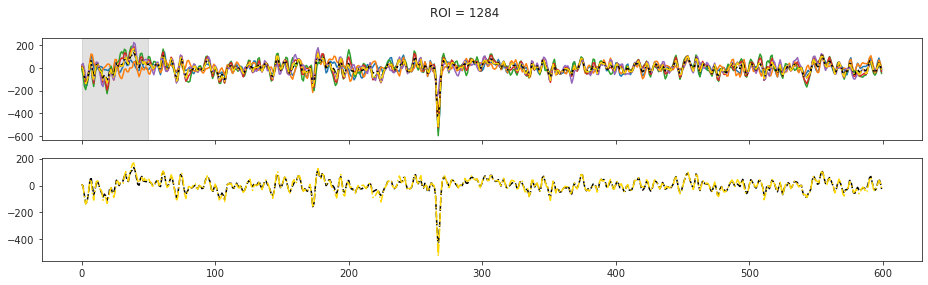

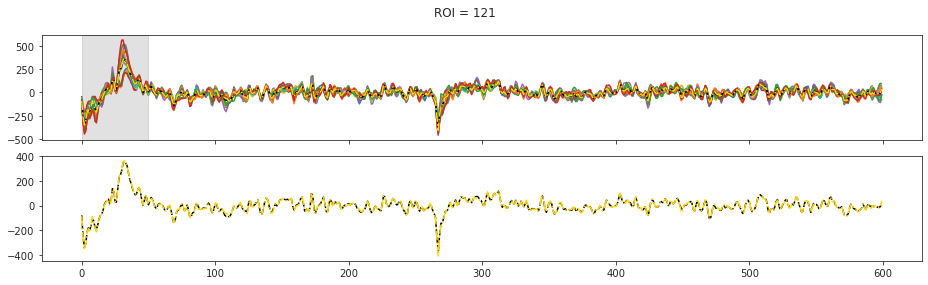

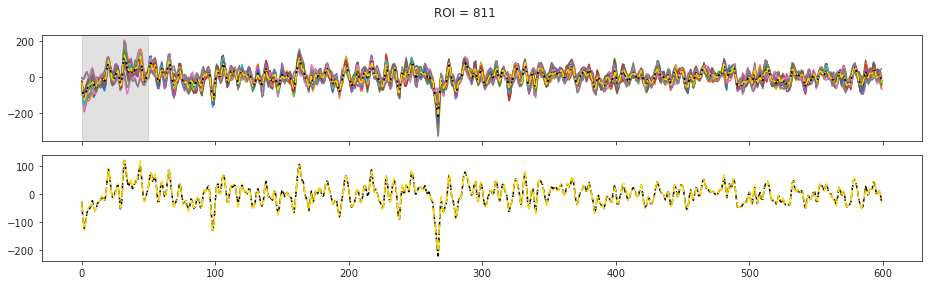

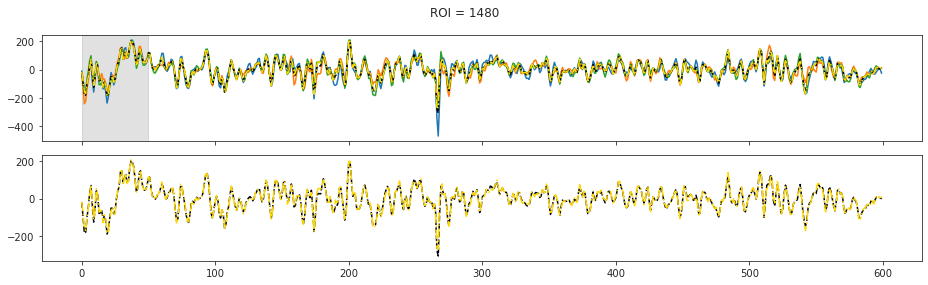

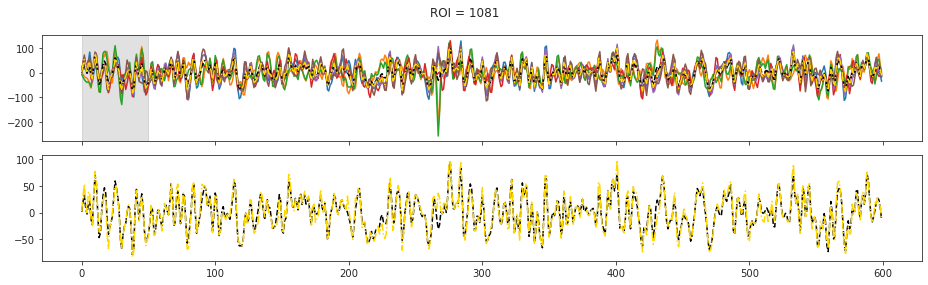

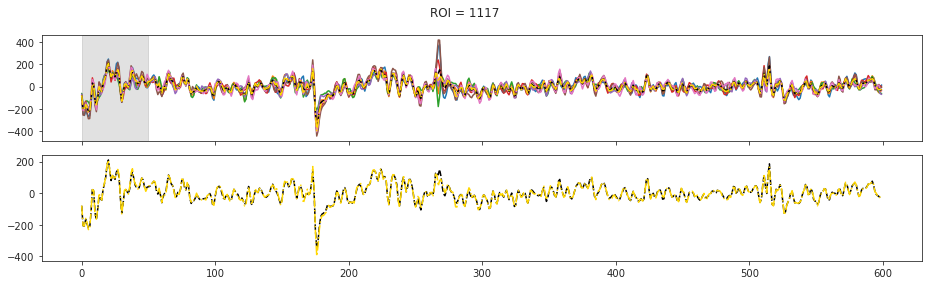

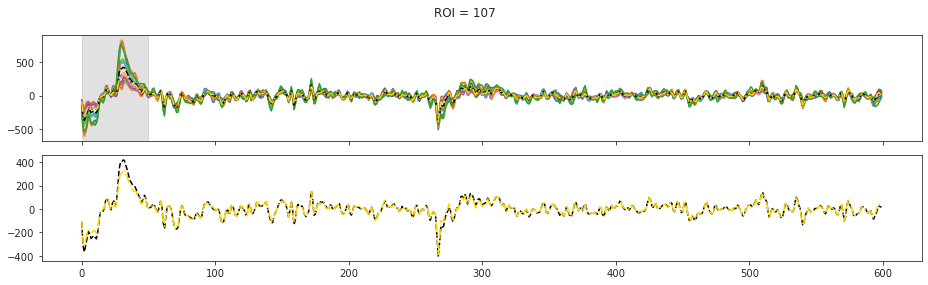

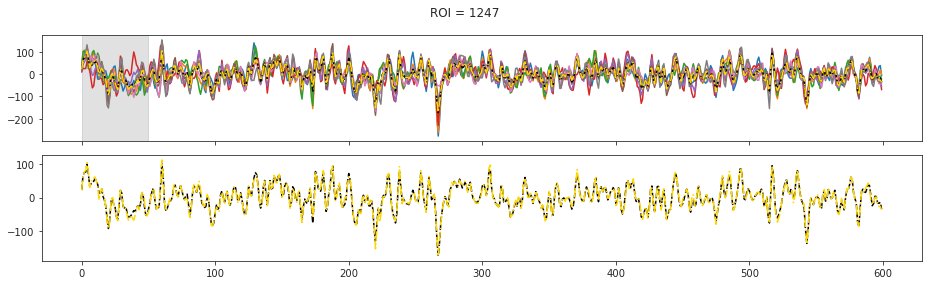

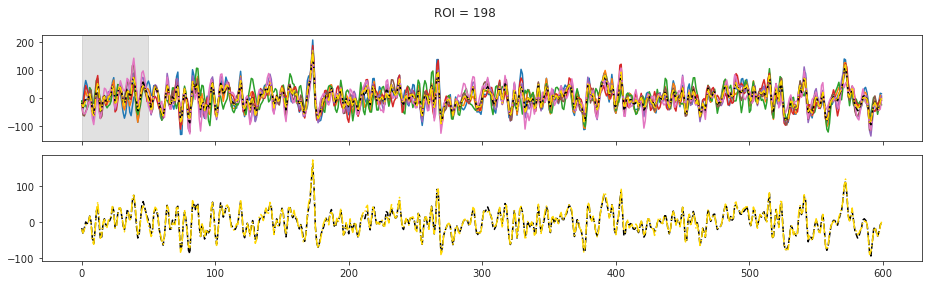

In [126]:
check = [1284, 121, 811, 1480, 1081, 1117, 107, 1247, 198]

for idx in check:
    fig, axes = create_figure(2, 1, (13, 4), 'all')
    axes[0].plot(data[idx].T)
    axes[0].plot(np.mean(data[idx], 0), color='k', ls='--')
    axes[0].plot(np.median(data[idx], 0), color='gold', ls='-.')
    axes[0].axvspan(0, 50, color='dimgrey', alpha=0.2)

    axes[1].plot(np.mean(data[idx], 0), color='k', ls='--')
    axes[1].plot(np.median(data[idx], 0), color='gold', ls='-.')

    fig.suptitle(f"ROI = {idx}")

    plt.show()
    print('\n')

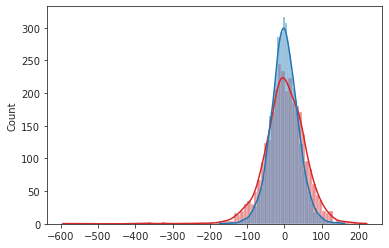

In [131]:
sns.histplot(data[1284].flat, kde=True, color='C3')
sns.histplot(data[14].flat,  kde=True, color='C0')
plt.show()

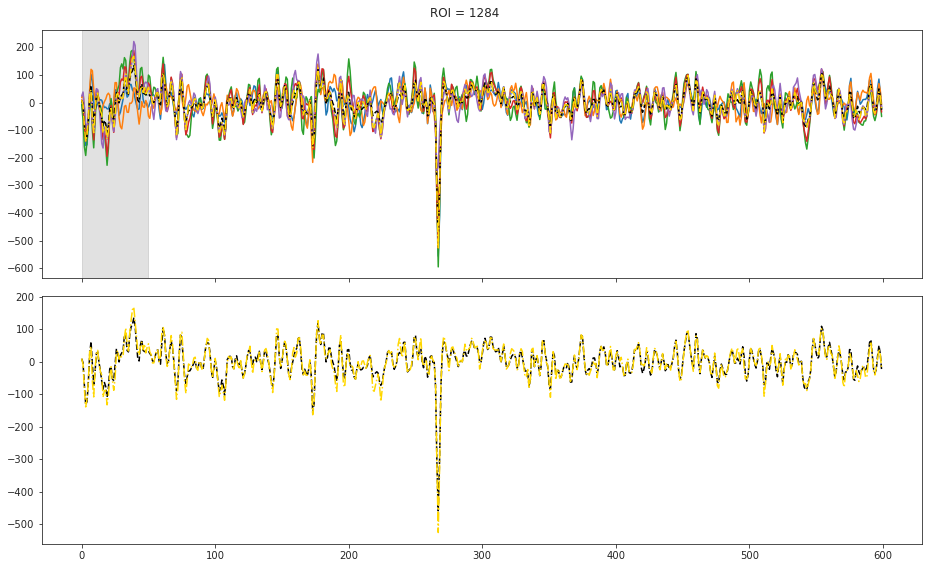

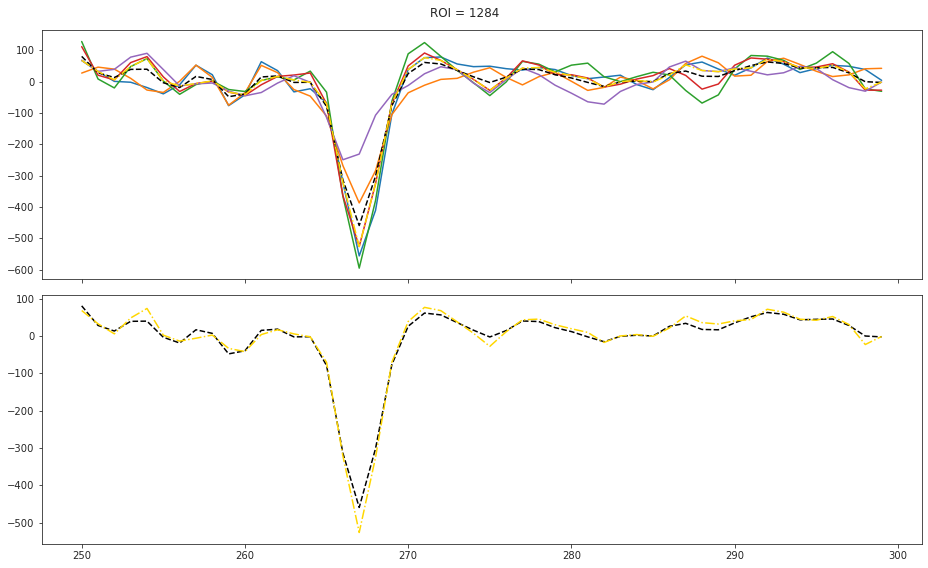

In [229]:
idx = 1284

fig, axes = create_figure(2, 1, (13, 8), 'all')
axes[0].plot(data[idx].T)
axes[0].plot(np.mean(data[idx], 0), color='k', ls='--')
axes[0].plot(np.median(data[idx], 0), color='gold', ls='-.')
axes[0].axvspan(0, 50, color='dimgrey', alpha=0.2)

axes[1].plot(np.mean(data[idx], 0), color='k', ls='--')
axes[1].plot(np.median(data[idx], 0), color='gold', ls='-.')

fig.suptitle(f"ROI = {idx}")

plt.show()


idx = 1284
intvl = range(250, 300)

fig, axes = create_figure(2, 1, (13, 8), 'all')
axes[0].plot(intvl, data[idx].T[intvl])
axes[0].plot(intvl, np.mean(data[idx], 0)[intvl], color='k', ls='--')
axes[0].plot(intvl, np.median(data[idx], 0)[intvl], color='gold', ls='-.')
# axes[0].axvspan(0, 50, color='dimgrey', alpha=0.2)

axes[1].plot(intvl, np.mean(data[idx], 0)[intvl], color='k', ls='--')
axes[1].plot(intvl, np.median(data[idx], 0)[intvl], color='gold', ls='-.')

fig.suptitle(f"ROI = {idx}")

plt.show()

In [230]:
idx

1284

<matplotlib.image.AxesImage object at 0x7f10675dc160>

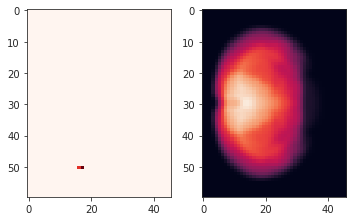

In [231]:
fig, axes = create_figure(1, 2, (5, 4))

axes[0].imshow(np.mean(roi_masks[idx], 2), cmap='Reds')
axes[1].imshow(np.mean(in_house.numpy(), 2))

<matplotlib.image.AxesImage object at 0x7f106de75970>

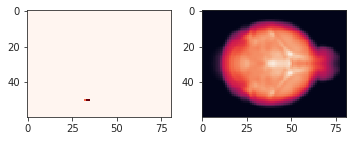

In [232]:
fig, axes = create_figure(1, 2, (5, 4))

axes[0].imshow(np.mean(roi_masks[idx], 1), cmap='Reds')
axes[1].imshow(np.mean(in_house.numpy(), 1))

In [233]:
mask_tr, roi_tr = filter_boundaries([mask, roi_masks[idx].copy()], mask)

<matplotlib.image.AxesImage object at 0x7f106d998be0>

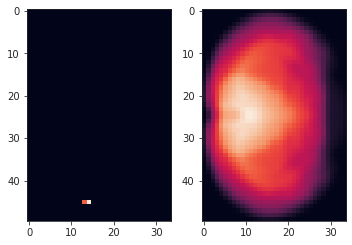

In [234]:
fig, axes = create_figure(1, 2, (5, 4))

axes[0].imshow(np.mean(roi_tr, 2))
axes[1].imshow(np.mean(in_house_tr, 2))

<matplotlib.image.AxesImage object at 0x7f106dea1190>

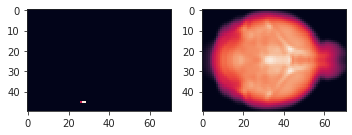

In [235]:
fig, axes = create_figure(1, 2, (5, 4))

axes[0].imshow(np.mean(roi_tr, 1))
axes[1].imshow(np.mean(in_house_tr, 1))

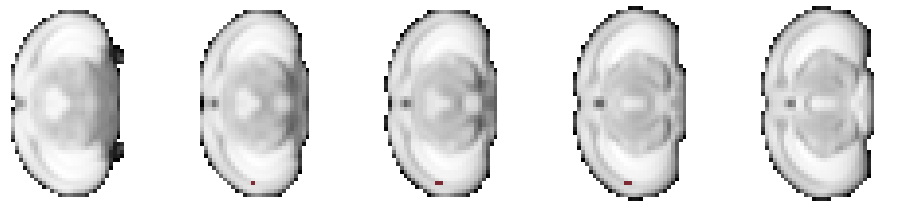

In [241]:
fig, axes = create_figure(1, 5, (13.5, 3))

for i, j in enumerate(range(25, 30)):
    ax = axes.ravel()[i]

    x2plt = np.ma.masked_where(~mask_tr[..., j], in_house_tr[..., j])
    ax.imshow(x2plt, cmap='Greys_r')

    x2plt = np.ma.masked_where(roi_tr[..., j] == 0, roi_tr[..., j])
    ax.imshow(x2plt, alpha=0.8, cmap='Reds_r')

remove_ticks(axes)
plt.show()

(0.7489066614541726, 0.032498348880884)

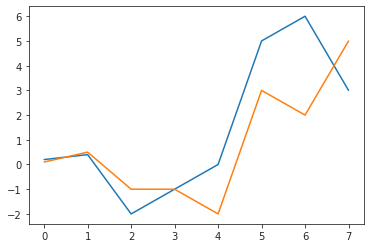

In [272]:
a = [0.2, 0.4, -2, -1, 0, 5, 6, 3]
b = [0.1, 0.5, -1, -1, -2, 3, 2, 5]
plt.plot(a)
plt.plot(b)

sp_stats.pearsonr(a, b)

In [273]:
from nancorrmp.nancorrmp import NaNCorrMp
x = pd.DataFrame({'a': a, 'b': b})
x

,a,b
0,0.2,0.1
1,0.4,0.5
2,-2.0,-1.0
3,-1.0,-1.0
4,0.0,-2.0
5,5.0,3.0
6,6.0,2.0
7,3.0,5.0


In [274]:
adj, p = NaNCorrMp.calculate_with_p_value(x)

In [275]:
adj

,a,b
a,1.000000,0.748907
b,0.748907,1.000000


In [276]:
p

,a,b
a,0.000000,0.032498
b,0.032498,0.000000


In [277]:
b = np.array(b)
a = np.array(a)
a[-1] = np.nan

a, b

(
    array([ 0.2,  0.4, -2. , -1. ,  0. ,  5. ,  6. ,  nan]),
    array([ 0.1,  0.5, -1. , -1. , -2. ,  3. ,  2. ,  5. ])
)

In [278]:
x = pd.DataFrame({'a': a, 'b': b})
adj, p = NaNCorrMp.calculate_with_p_value(x)

In [279]:
adj

,a,b
a,1.000000,0.871461
b,0.871461,1.000000


In [280]:
p

,a,b
a,0.000000,0.010604
b,0.010604,0.000000


In [281]:
sp_stats.pearsonr(a[:-1], b[:-1])

(0.8714607571000534, 0.010603830852222638)

In [351]:
roi_masks = {
    idx: cortex == idx for idx in
    np.unique(cortex[cortex.nonzero()])
}

key = 'sub-SLC02_ses-3_run-5'
file = next(
    f for f in os.listdir(mice.cfg.npy_dir)
    if all(e in f for e in [key, 'N162'])
)
x = np.load(pjoin(mice.cfg.npy_dir, file))
x = {
    idx: x[np.logical_and(m,  mask)].mean(0)
    for idx, m in roi_masks.items()
}

In [352]:
dlist = []
for idx, vec in x.items():
    dlist.append({
        'ROI': [idx] * len(vec),
        'time': range(len(vec)),
        'x': vec.ravel(),
    })
df = pd.DataFrame(merge_dicts(dlist))

In [353]:
df

,ROI,time,x
0,1,0,-16.131296
1,1,1,-52.712127
2,1,2,-81.615705
3,1,3,-89.710094
4,1,4,-91.278958
...,...,...,...
840595,1529,595,32.161869
840596,1529,596,15.828598
840597,1529,597,-4.961240
840598,1529,598,6.615995


<AxesSubplot:xlabel='time', ylabel='x'>

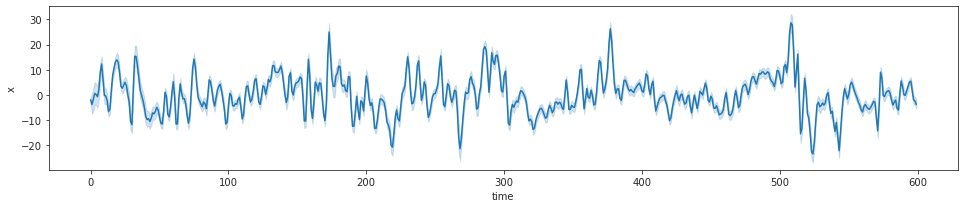

In [298]:
fig, ax = create_figure(1, 1, (13.5, 3))
sns.lineplot(data=df, x='time', y='x', ax=ax)

In [302]:
test = np.concatenate([e.reshape(1, -1) for e in x.values()])
test.shape

(1401, 600)

[<matplotlib.lines.Line2D object at 0x7f1077a88cd0>]

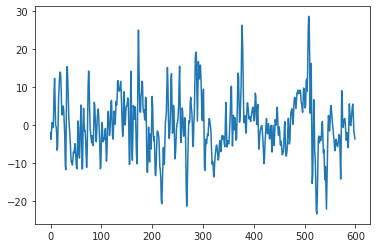

In [303]:
plt.plot(test.mean(0))

[<matplotlib.lines.Line2D object at 0x7f111c4ff0d0>]

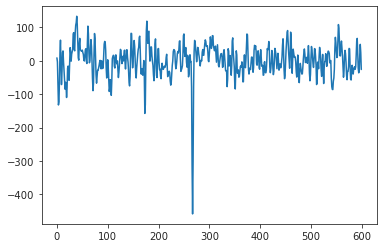

<matplotlib.patches.Polygon object at 0x7f106e35e910>

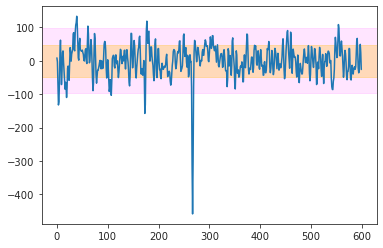

In [319]:
nb_sds = 2

idx = 1284
sd = x[idx].std()

plt.plot(x[idx])
plt.axhspan(-sd, sd, color='gold', alpha=0.3)
plt.axhspan(-nb_sds * sd, nb_sds * sd, color='magenta', alpha=0.1)

In [320]:
nb_sds = 2
bad_time = np.where(np.abs(x[idx]) > nb_sds * x[idx].std())[0]
bad_time

array([  3,   4,  19,  37,  38,  39,  40,  61, 107, 173, 174, 177, 266,
       267, 268, 554, 555])

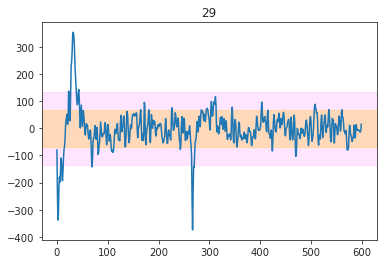

In [326]:
nb_sds = 2

idx = 121
sd = x[idx].std()

plt.plot(x[idx])
plt.axhspan(-sd, sd, color='gold', alpha=0.3)
plt.axhspan(-nb_sds * sd, nb_sds * sd, color='magenta', alpha=0.1)

bad_time = np.where(np.abs(x[idx]) > nb_sds * sd)[0]
plt.title(len(bad_time))

plt.show()

In [327]:
bad_time

array([  1,   2,   3,   4,   5,   6,   7,  10,  11,  12,  23,  28,  29,
        30,  31,  32,  33,  34,  35,  36,  37,  38,  43,  69, 266, 267,
       268, 269, 270])

In [328]:
check

[1284, 121, 811, 1480, 1081, 1117, 107, 1247, 198]

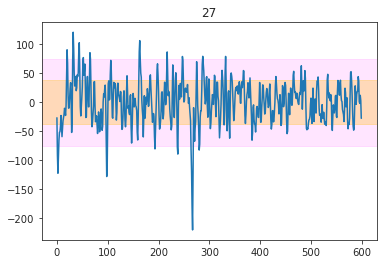

In [329]:
nb_sds = 2

idx = 811
sd = x[idx].std()

plt.plot(x[idx])
plt.axhspan(-sd, sd, color='gold', alpha=0.3)
plt.axhspan(-nb_sds * sd, nb_sds * sd, color='magenta', alpha=0.1)

bad_time = np.where(np.abs(x[idx]) > nb_sds * sd)[0]
plt.title(len(bad_time))

plt.show()

In [330]:
bad_time

array([  1,   2,   3,  20,  32,  33,  43,  44,  52,  65,  98,  99, 162,
       163, 193, 217, 237, 238, 247, 264, 265, 266, 267, 268, 280, 287,
       332])

In [354]:
nb_sds = 2
bad_timepoints = {}
sds = {}

for idx, vec in x.items():
    sd = vec.std()
    bad = np.where(np.abs(vec) > nb_sds * sd)[0]
    
    sds[idx] = sd
    bad_timepoints[idx] = bad

<AxesSubplot:ylabel='Count'>

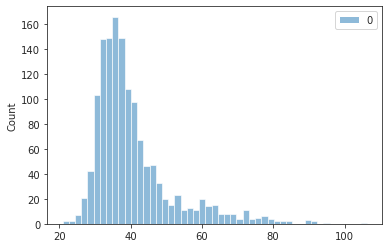

In [355]:
sns.histplot(sds.values())

In [356]:
max(sds.items(), key=lambda z: z[1])

(186, 106.26385247577741)

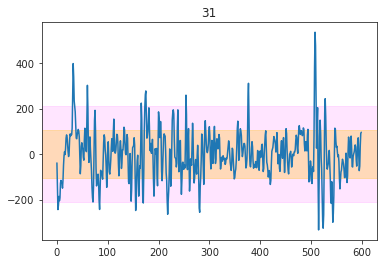

In [357]:
nb_sds = 2

idx = 186
sd = x[idx].std()

plt.plot(x[idx])
plt.axhspan(-sd, sd, color='gold', alpha=0.3)
plt.axhspan(-nb_sds * sd, nb_sds * sd, color='magenta', alpha=0.1)

bad_time = np.where(np.abs(x[idx]) > nb_sds * sd)[0]
plt.title(len(bad_time))

plt.show()

In [358]:
x_filt = {}
for idx, bad_ids in bad_timepoints.items():
    vec = x[idx].copy()
    np.put(vec, bad_ids, np.nan)
    x_filt[idx] = vec

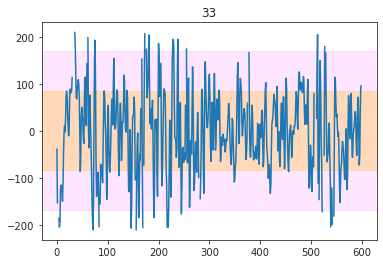

In [360]:
nb_sds = 2

idx = 186
sd = np.nanstd(x_filt[idx])

plt.plot(x_filt[idx])
plt.axhspan(-sd, sd, color='gold', alpha=0.3)
plt.axhspan(-nb_sds * sd, nb_sds * sd, color='magenta', alpha=0.1)

bad_time = np.where(np.abs(x_filt[idx]) > nb_sds * sd)[0]
plt.title(len(bad_time))

plt.show()

In [361]:
sds_filt = {idx: np.nanstd(vec) for idx, vec in x_filt.items()}

<AxesSubplot:ylabel='Count'>

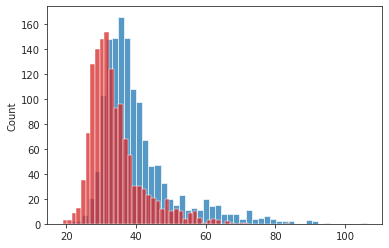

In [368]:
sns.histplot(list(sds.values()), color='C0')
sns.histplot(list(sds_filt.values()), color='C3')

In [369]:
max(sds.items(), key=lambda z: z[1]), max(sds_filt.items(), key=lambda z: z[1])

((186, 106.26385247577741), (186, 84.28929105230829))

In [372]:
from nancorrmp.nancorrmp import NaNCorrMp

adj, p = NaNCorrMp.calculate_with_p_value(pd.DataFrame(x))
adj_filt, p_filt = NaNCorrMp.calculate_with_p_value(pd.DataFrame(x_filt))

In [379]:
adj = adj.values
adj_filt = adj_filt.values

np.fill_diagonal(adj, 0.)
np.fill_diagonal(adj_filt, 0.)

<matplotlib.colorbar.Colorbar object at 0x7f106fa46190>

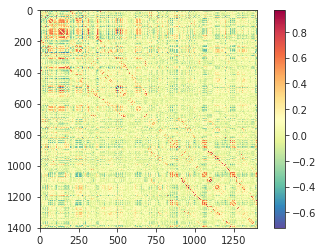

In [383]:
plt.imshow(adj, cmap='Spectral_r')
plt.colorbar()

<matplotlib.colorbar.Colorbar object at 0x7f106f6712e0>

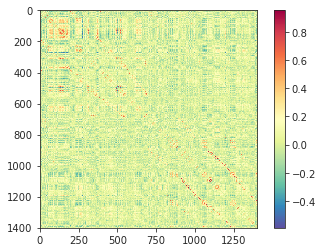

In [384]:
plt.imshow(adj_filt, cmap='Spectral_r')
plt.colorbar()

In [390]:
base = Base(mice, key=key, mode='bold-lite')

In [391]:
base.data.shape

(300, 550)

In [393]:
list(base.l2n)

[
    '1-8-0',
    '1-9-0',
    '1-14-0',
    '1-15-0',
    '1-17-0',
    '1-19-0',
    '1-20-0',
    '1-22-0',
    '1-23-0',
    '1-24-0',
    '1-25-0',
    '1-27-0',
    '1-28-0',
    '1-30-0',
    '1-32-0',
    '1-33-0',
    '1-36-0',
    '1-37-0',
    '1-38-0',
    '1-40-0',
    '1-41-0',
    '1-43-0',
    '1-45-0',
    '1-46-0',
    '1-47-0',
    '1-49-0',
    '1-50-0',
    '1-51-0',
    '1-52-0',
    '1-53-0',
    '1-56-0',
    '1-58-0',
    '1-60-0',
    '1-61-0',
    '1-62-0',
    '1-63-0',
    '1-65-0',
    '1-66-0',
    '1-68-0',
    '1-69-0',
    '1-71-0',
    '1-73-0',
    '1-74-0',
    '1-75-0',
    '1-76-0',
    '1-78-0',
    '1-79-0',
    '1-80-0',
    '1-81-0',
    '1-83-0',
    '1-85-0',
    '1-86-0',
    '1-88-0',
    '1-89-0',
    '1-90-0',
    '1-91-0',
    '1-93-0',
    '1-94-0',
    '1-96-0',
    '1-97-0',
    '1-99-0',
    '1-100-0',
    '1-102-0',
    '1-103-0',
    '1-105-0',
    '1-106-0',
    '1-107-0',
    '1-109-0',
    '1-111-0',
    '1-112-0',
    '1-114-0',
    '1-115-0',
    '1-116-0',
    '1-117-0',
    '1-119-0',
    '1-120-0',
    '1-121-0',
    '1-121-1',
    '1-123-0',
    '1-124-0',
    '1-126-0',
    '1-128-0',
    '1-129-0',
    '1-130-0',
    '1-131-0',
    '1-133-0',
    '1-134-0',
    '1-134-1',
    '1-135-0',
    '1-135-1',
    '1-137-0',
    '1-137-1',
    '1-138-0',
    '1-138-1',
    '1-139-0',
    '1-139-1',
    '1-140-0',
    '1-141-0',
    '1-142-0',
    '1-143-0',
    '1-143-1',
    '1-146-0',
    '1-147-0',
    '1-147-1',
    '1-148-0',
    '1-148-1',
    '1-149-0',
    '1-149-1',
    '1-151-0',
    '1-152-0',
    '1-152-1',
    '1-153-0',
    '1-153-1',
    '1-154-0',
    '1-155-0',
    '1-157-0',
    '1-159-0',
    '1-159-1',
    '1-160-0',
    '1-161-0',
    '1-161-1',
    '1-162-0',
    '1-162-1',
    '1-163-0',
    '1-164-0',
    '1-165-0',
    '1-167-0',
    '1-169-0',
    '1-170-0',
    '1-170-1',
    '1-171-0',
    '1-172-0',
    '1-172-1',
    '1-173-0',
    '1-173-1',
    '1-174-0',
    '1-174-1',
    '1-175-0',
    '1-177-0',
    '1-178-0',
    '1-179-0',
    '1-179-1',
    '1-180-0',
    '1-181-0',
    '1-182-0',
    '1-183-0',
    '1-184-0',
    '1-184-1',
    '1-186-0',
    '1-187-0',
    '2-8-0',
    '2-9-0',
    '2-14-0',
    '2-15-0',
    '2-17-0',
    '2-19-0',
    '2-20-0',
    '2-22-0',
    '2-23-0',
    '2-24-0',
    '2-25-0',
    '2-27-0',
    '2-28-0',
    '2-30-0',
    '2-32-0',
    '2-33-0',
    '2-36-0',
    '2-37-0',
    '2-38-0',
    '2-40-0',
    '2-41-0',
    '2-43-0',
    '2-45-0',
    '2-46-0',
    '2-47-0',
    '2-49-0',
    '2-50-0',
    '2-51-0',
    '2-52-0',
    '2-53-0',
    '2-56-0',
    '2-58-0',
    '2-60-0',
    '2-61-0',
    '2-62-0',
    '2-63-0',
    '2-65-0',
    '2-66-0',
    '2-68-0',
    '2-69-0',
    '2-71-0',
    '2-73-0',
    '2-74-0',
    '2-75-0',
    '2-76-0',
    '2-78-0',
    '2-79-0',
    '2-80-0',
    '2-81-0',
    '2-83-0',
    '2-85-0',
    '2-86-0',
    '2-88-0',
    '2-89-0',
    '2-90-0',
    '2-91-0',
    '2-93-0',
    '2-94-0',
    '2-96-0',
    '2-97-0',
    '2-99-0',
    '2-100-0',
    '2-102-0',
    '2-103-0',
    '2-105-0',
    '2-106-0',
    '2-107-0',
    '2-109-0',
    '2-111-0',
    '2-112-0',
    '2-114-0',
    '2-115-0',
    '2-116-0',
    '2-117-0',
    '2-119-0',
    '2-120-0',
    '2-121-0',
    '2-121-1',
    '2-123-0',
    '2-124-0',
    '2-126-0',
    '2-128-0',
    '2-129-0',
    '2-130-0',
    '2-131-0',
    '2-133-0',
    '2-134-0',
    '2-134-1',
    '2-135-0',
    '2-135-1',
    '2-137-0',
    '2-137-1',
    '2-138-0',
    '2-138-1',
    '2-139-0',
    '2-139-1',
    '2-140-0',
    '2-141-0',
    '2-142-0',
    '2-143-0',
    '2-143-1',
    '2-146-0',
    '2-147-0',
    '2-147-1',
    '2-148-0',
    '2-148-1',
    '2-149-0',
    '2-149-1',
    '2-151-0',
    '2-152-0',
    '2-152-1',
    '2-153-0',
    '2-153-1',
    '2-154-0',
    '2-155-0',
    '2-157-0',
    '2-159-0',
    '2-159-1',
    '2-160-0',
    '2-161-0',
    '2-161-1',
    '2-162-0',
    '2-162-1',
    '2-163-0',
    '2-164-0',

In [399]:
roi_idx = []
for lbl in base.l2n:
    roi_idx.append(mice.parcel.encode(lbl))

In [400]:
roi_idx

[
    8,
    9,
    14,
    15,
    17,
    19,
    20,
    22,
    23,
    24,
    25,
    27,
    28,
    30,
    32,
    33,
    36,
    37,
    38,
    40,
    41,
    43,
    45,
    46,
    47,
    49,
    50,
    51,
    52,
    53,
    56,
    58,
    60,
    61,
    62,
    63,
    65,
    66,
    68,
    69,
    71,
    73,
    74,
    75,
    76,
    78,
    79,
    80,
    81,
    83,
    85,
    86,
    88,
    89,
    90,
    91,
    93,
    94,
    96,
    97,
    99,
    100,
    102,
    103,
    105,
    106,
    107,
    109,
    111,
    112,
    114,
    115,
    116,
    117,
    119,
    120,
    121,
    313,
    123,
    124,
    126,
    128,
    129,
    130,
    131,
    133,
    134,
    326,
    135,
    327,
    137,
    329,
    138,
    330,
    139,
    331,
    140,
    141,
    142,
    143,
    335,
    146,
    147,
    339,
    148,
    340,
    149,
    341,
    151,
    152,
    344,
    153,
    345,
    154,
    155,
    157,
    159,
    351,
    160,
    161,
    353,
    162,
    354,
    163,
    164,
    165,
    167,
    169,
    170,
    362,
    171,
    172,
    364,
    173,
    365,
    174,
    366,
    175,
    177,
    178,
    179,
    371,
    180,
    181,
    182,
    183,
    184,
    376,
    186,
    187,
    776,
    777,
    782,
    783,
    785,
    787,
    788,
    790,
    791,
    792,
    793,
    795,
    796,
    798,
    800,
    801,
    804,
    805,
    806,
    808,
    809,
    811,
    813,
    814,
    815,
    817,
    818,
    819,
    820,
    821,
    824,
    826,
    828,
    829,
    830,
    831,
    833,
    834,
    836,
    837,
    839,
    841,
    842,
    843,
    844,
    846,
    847,
    848,
    849,
    851,
    853,
    854,
    856,
    857,
    858,
    859,
    861,
    862,
    864,
    865,
    867,
    868,
    870,
    871,
    873,
    874,
    875,
    877,
    879,
    880,
    882,
    883,
    884,
    885,
    887,
    888,
    889,
    1081,
    891,
    892,
    894,
    896,
    897,
    898,
    899,
    901,
    902,
    1094,
    903,
    1095,
    905,
    1097,
    906,
    1098,
    907,
    1099,
    908,
    909,
    910,
    911,
    1103,
    914,
    915,
    1107,
    916,
    1108,
    917,
    1109,
    919,
    920,
    1112,
    921,
    1113,
    922,
    923,
    925,
    927,
    1119,
    928,
    929,
    1121,
    930,
    1122,
    931,
    932,
    933,
    935,
    937,
    938,
    1130,
    939,
    940,
    1132,
    941,
    1133,
    942,
    1134,
    943,
    945,
    946,
    947,
    1139,
    948,
    949,
    950,
    951,
    952,
    1144,
    954,
    955
]

In [402]:
selected_is = []
for i, idx in enumerate(x):
    if idx in roi_idx:
        selected_is.append(i)

In [403]:
selected_is

[
    7,
    8,
    13,
    14,
    16,
    18,
    19,
    21,
    22,
    23,
    24,
    26,
    27,
    29,
    31,
    32,
    35,
    36,
    37,
    39,
    40,
    42,
    44,
    45,
    46,
    48,
    49,
    50,
    51,
    52,
    55,
    57,
    59,
    60,
    61,
    62,
    64,
    65,
    67,
    68,
    70,
    72,
    73,
    74,
    75,
    77,
    78,
    79,
    80,
    82,
    84,
    85,
    87,
    88,
    89,
    90,
    92,
    93,
    95,
    96,
    98,
    99,
    101,
    102,
    104,
    105,
    106,
    108,
    110,
    111,
    113,
    114,
    115,
    116,
    118,
    119,
    120,
    122,
    123,
    125,
    127,
    128,
    129,
    130,
    132,
    133,
    134,
    136,
    137,
    138,
    139,
    140,
    141,
    142,
    145,
    146,
    147,
    148,
    150,
    151,
    152,
    153,
    154,
    156,
    157,
    158,
    159,
    160,
    161,
    162,
    163,
    165,
    167,
    168,
    169,
    170,
    171,
    172,
    173,
    175,
    176,
    177,
    178,
    179,
    180,
    181,
    182,
    184,
    185,
    310,
    323,
    324,
    326,
    327,
    328,
    332,
    336,
    337,
    338,
    340,
    341,
    347,
    349,
    350,
    358,
    360,
    361,
    362,
    367,
    372,
    702,
    703,
    708,
    709,
    711,
    713,
    714,
    716,
    717,
    718,
    719,
    721,
    722,
    724,
    726,
    727,
    730,
    731,
    732,
    734,
    735,
    737,
    739,
    740,
    741,
    743,
    744,
    745,
    746,
    747,
    750,
    752,
    754,
    755,
    756,
    757,
    759,
    760,
    762,
    763,
    765,
    767,
    768,
    769,
    770,
    772,
    773,
    774,
    775,
    777,
    779,
    780,
    782,
    783,
    784,
    785,
    787,
    788,
    790,
    791,
    793,
    794,
    796,
    797,
    799,
    800,
    801,
    803,
    805,
    806,
    808,
    809,
    810,
    811,
    813,
    814,
    815,
    817,
    818,
    820,
    822,
    823,
    824,
    825,
    827,
    828,
    829,
    831,
    832,
    833,
    834,
    835,
    836,
    837,
    840,
    841,
    842,
    843,
    845,
    846,
    847,
    848,
    849,
    851,
    853,
    854,
    855,
    856,
    857,
    858,
    859,
    861,
    863,
    864,
    865,
    866,
    867,
    868,
    869,
    871,
    872,
    873,
    874,
    875,
    876,
    877,
    878,
    880,
    881,
    1005,
    1018,
    1019,
    1021,
    1022,
    1023,
    1027,
    1031,
    1032,
    1033,
    1036,
    1037,
    1043,
    1045,
    1046,
    1054,
    1056,
    1057,
    1058,
    1063,
    1068
]

<matplotlib.colorbar.Colorbar object at 0x7f106f4cd2b0>

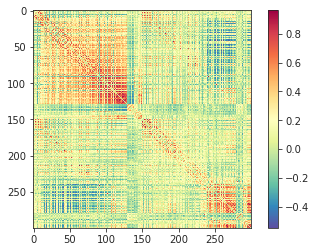

In [406]:
plt.imshow(adj[selected_is][:, selected_is], cmap='Spectral_r')
plt.colorbar()

<matplotlib.colorbar.Colorbar object at 0x7f1077e76610>

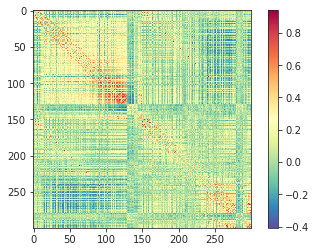

In [407]:
plt.imshow(adj_filt[selected_is][:, selected_is], cmap='Spectral_r')
plt.colorbar()

In [415]:
base = Base(mice, key=key, mode='bold')

In [416]:
roi_idx = []
for lbl in base.l2n:
    if int(lbl.split('-')[-1]) == 1:
        roi_idx.append(mice.parcel.encode(lbl))

In [417]:
selected_is = []
for i, idx in enumerate(x):
    if idx in roi_idx:
        selected_is.append(i)

<matplotlib.colorbar.Colorbar object at 0x7f1075e7e850>

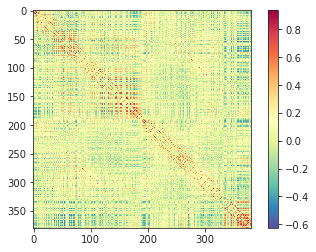

In [421]:
plt.imshow(adj[selected_is][:, selected_is], cmap='Spectral_r')
plt.colorbar()

<matplotlib.colorbar.Colorbar object at 0x7f106d8375e0>

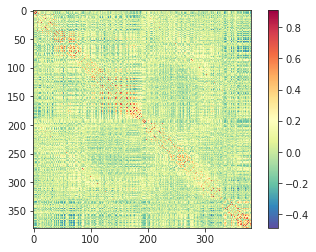

In [422]:
plt.imshow(adj_filt[selected_is][:, selected_is], cmap='Spectral_r')
plt.colorbar()

## TODO: erode the mask

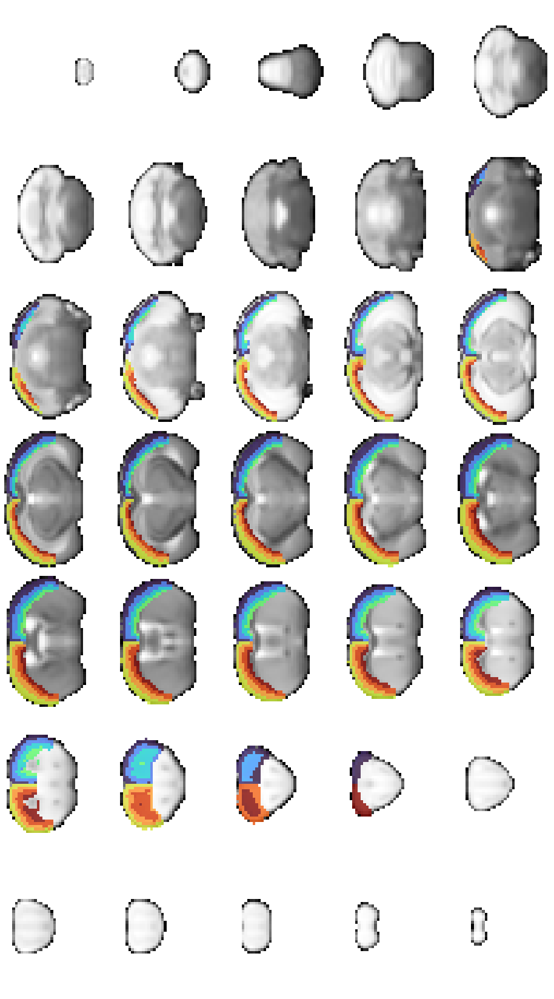

In [435]:
fig, axes = create_figure(7, 5, (13.5, 23))

for i, j in enumerate(range(1, 71, 2)):
    ax = axes.ravel()[i]

    x2plt = np.ma.masked_where(~mask_tr[..., j], in_house_tr[..., j])
    ax.imshow(x2plt, cmap='Greys_r')

    x2plt = np.ma.masked_where(cortex_tr[..., j] == 0, cortex_tr[..., j])
    ax.imshow(x2plt, alpha=0.8, cmap='turbo')

remove_ticks(axes)
plt.show()

In [436]:


ll = 0

roi_idx = []
for lbl in base.l2n:
    if int(lbl.split('-')[-1]) == ll:
        roi_idx.append(mice.parcel.encode(lbl))

selected_is = []
for i, idx in enumerate(x):
    if idx in roi_idx:
        selected_is.append(i)

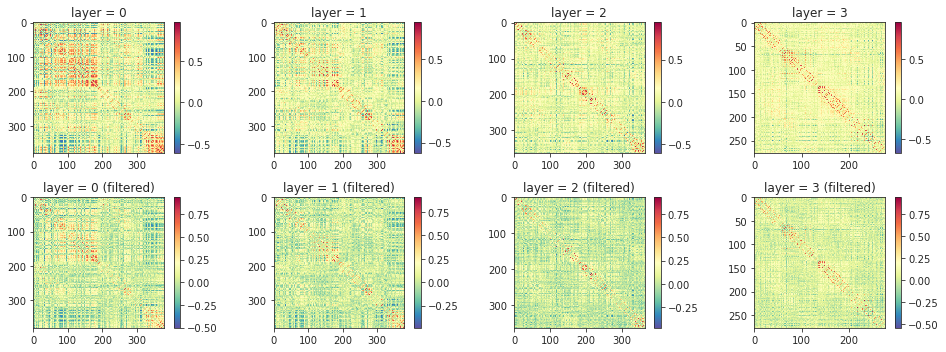

In [447]:
base = Base(mice, key=key, mode='bold')

fig, axes = create_figure(2, 4, (13.5, 5))

for ll in range(4):
    roi_idx, selected_is = [], []
    for lbl in base.l2n:
        if int(lbl.split('-')[-1]) == ll:
            roi_idx.append(mice.parcel.encode(lbl))
    for i, idx in enumerate(x):
        if idx in roi_idx:
            selected_is.append(i)

    im = axes[0, ll].imshow(adj[selected_is][:, selected_is], cmap='Spectral_r')
    plt.colorbar(im, ax=axes[0, ll])
    axes[0, ll].set_title(f"layer = {ll}")

    im = axes[1, ll].imshow(adj_filt[selected_is][:, selected_is], cmap='Spectral_r')
    plt.colorbar(im, ax=axes[1, ll])
    axes[1, ll].set_title(f"layer = {ll} (filtered)")
    
plt.show()

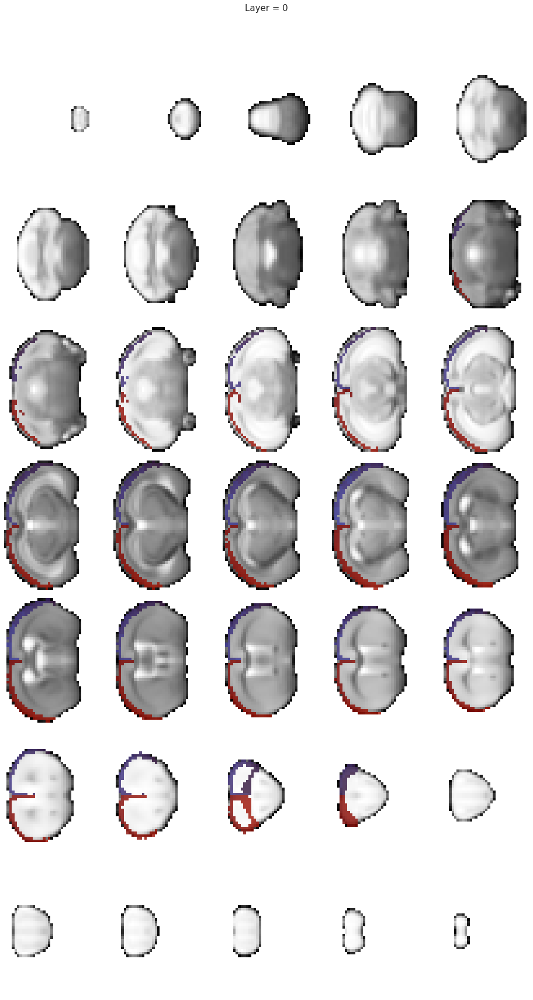

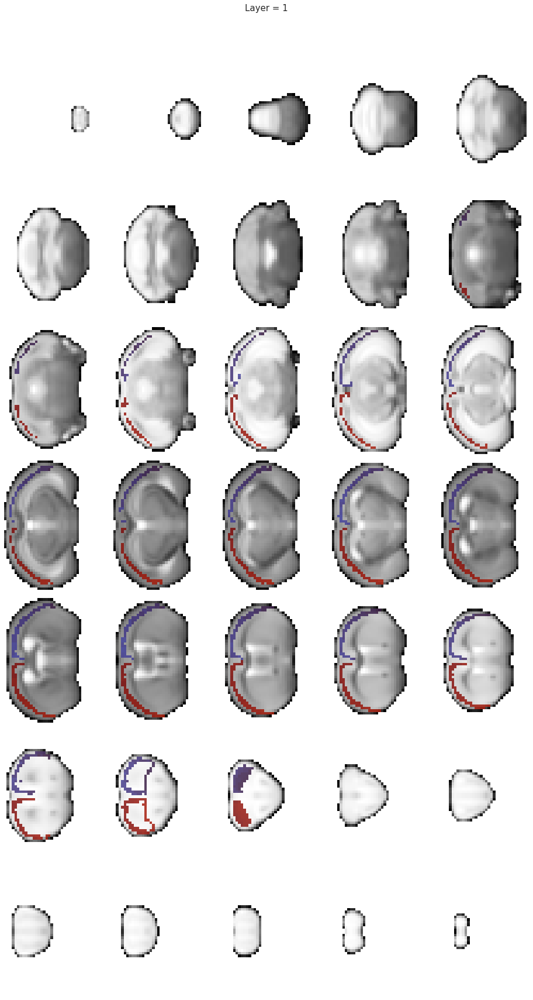

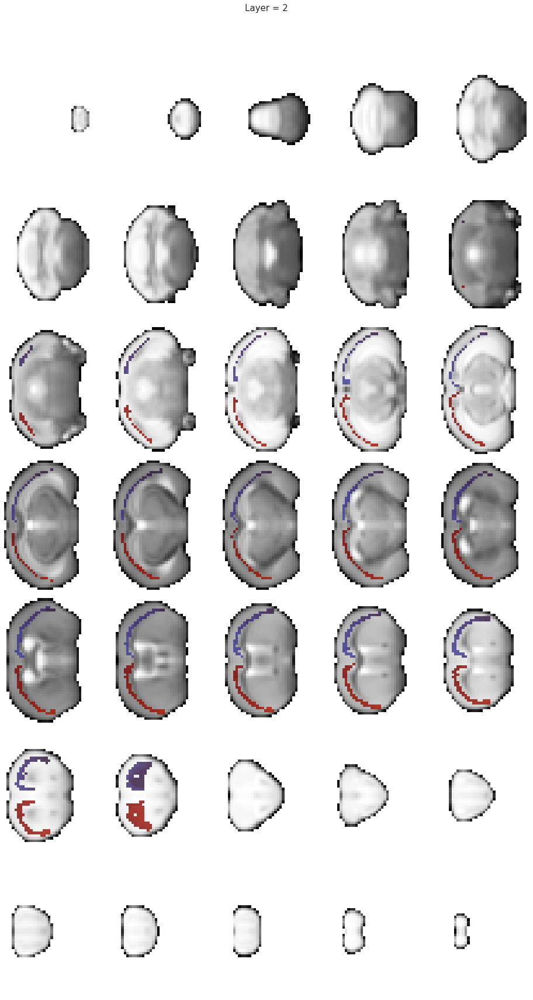

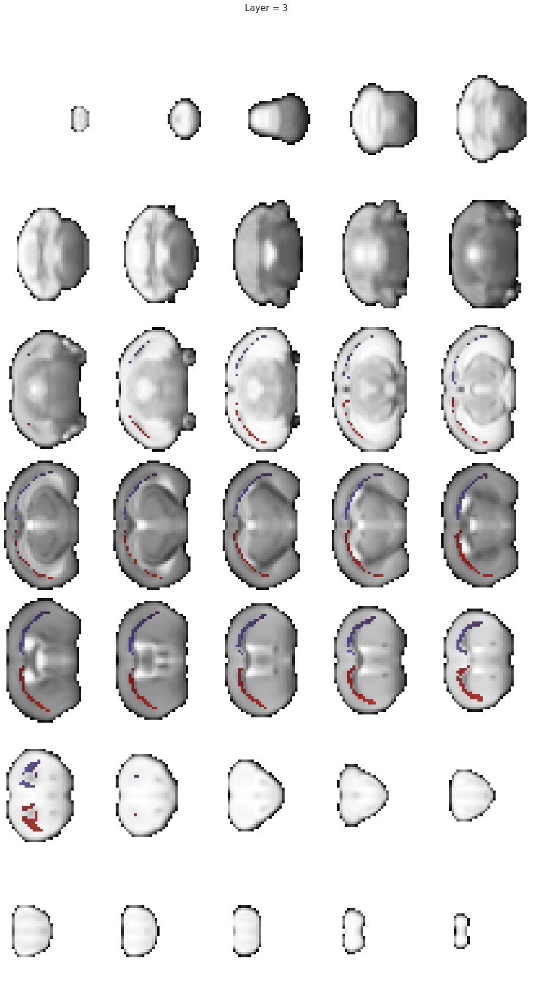

In [455]:
base = Base(mice, key=key, mode='bold')

for ll in range(4):
    roi_idx, selected_is = [], []
    for lbl in base.l2n:
        if int(lbl.split('-')[-1]) == ll:
            roi_idx.append(mice.parcel.encode(lbl))
            
    fig, axes = create_figure(7, 5, (13.5, 23))
    for i, j in enumerate(range(1, 71, 2)):
        ax = axes.ravel()[i]

        x2plt = np.ma.masked_where(~mask_tr[..., j], in_house_tr[..., j])
        ax.imshow(x2plt, cmap='Greys_r')

        x2plt = np.ma.masked_where(~np.isin(cortex_tr[..., j], roi_idx), cortex_tr[..., j])
        ax.imshow(x2plt, alpha=0.8, cmap='turbo')
    fig.suptitle(f"Layer = {ll}", fontsize=15, y=1.03)
    remove_ticks(axes)
    plt.show()

<matplotlib.image.AxesImage object at 0x7f106463c0d0>

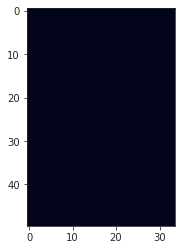

In [452]:
plt.imshow()

In [442]:
selected_is

[
    560,
    561,
    562,
    563,
    564,
    565,
    566,
    567,
    568,
    569,
    570,
    571,
    572,
    573,
    574,
    575,
    576,
    577,
    578,
    579,
    580,
    581,
    582,
    583,
    584,
    585,
    586,
    587,
    588,
    589,
    590,
    591,
    592,
    593,
    594,
    595,
    596,
    597,
    598,
    599,
    600,
    601,
    602,
    603,
    604,
    605,
    606,
    607,
    608,
    609,
    610,
    611,
    612,
    613,
    614,
    615,
    616,
    617,
    618,
    619,
    620,
    621,
    622,
    623,
    624,
    625,
    626,
    627,
    628,
    629,
    630,
    631,
    632,
    633,
    634,
    635,
    636,
    637,
    638,
    639,
    640,
    641,
    642,
    643,
    644,
    645,
    646,
    647,
    648,
    649,
    650,
    651,
    652,
    653,
    654,
    655,
    656,
    657,
    658,
    659,
    660,
    661,
    662,
    663,
    664,
    665,
    666,
    667,
    668,
    669,
    670,
    671,
    672,
    673,
    674,
    675,
    676,
    677,
    678,
    679,
    680,
    681,
    682,
    683,
    684,
    685,
    686,
    687,
    688,
    689,
    690,
    691,
    692,
    693,
    694,
    1259,
    1260,
    1261,
    1262,
    1263,
    1264,
    1265,
    1266,
    1267,
    1268,
    1269,
    1270,
    1271,
    1272,
    1273,
    1274,
    1275,
    1276,
    1277,
    1278,
    1279,
    1280,
    1281,
    1282,
    1283,
    1284,
    1285,
    1286,
    1287,
    1288,
    1289,
    1290,
    1291,
    1292,
    1293,
    1294,
    1295,
    1296,
    1297,
    1298,
    1299,
    1300,
    1301,
    1302,
    1303,
    1304,
    1305,
    1306,
    1307,
    1308,
    1309,
    1310,
    1311,
    1312,
    1313,
    1314,
    1315,
    1316,
    1317,
    1318,
    1319,
    1320,
    1321,
    1322,
    1323,
    1324,
    1325,
    1326,
    1327,
    1328,
    1329,
    1330,
    1331,
    1332,
    1333,
    1334,
    1335,
    1336,
    1337,
    1338,
    1339,
    1340,
    1341,
    1342,
    1343,
    1344,
    1345,
    1346,
    1347,
    1348,
    1349,
    1350,
    1351,
    1352,
    1353,
    1354,
    1355,
    1356,
    1357,
    1358,
    1359,
    1360,
    1361,
    1362,
    1363,
    1364,
    1365,
    1366,
    1367,
    1368,
    1369,
    1370,
    1371,
    1372,
    1373,
    1374,
    1375,
    1376,
    1377,
    1378,
    1379,
    1380,
    1381,
    1382,
    1383,
    1384,
    1385,
    1386,
    1387,
    1388,
    1389,
    1390,
    1391,
    1392,
    1393,
    1394,
    1395,
    1396,
    1397,
    1398,
    1399,
    1400
]

In [392]:
vars(base)

{
    'style': {},
    'mode': 'bold-lite',
    'task': 'rest',
    'metric': 'correlation',
    'verbose': True,
    'key': 'sub-SLC02_ses-3_run-5',
    'num_k': 6,
    'cmaps': {
        1: <matplotlib.colors.LinearSegmentedColormap object at 0x7f106f19b970>,
        2: <matplotlib.colors.LinearSegmentedColormap object at 0x7f106f19b9a0>,
        3: <matplotlib.colors.LinearSegmentedColormap object at 0x7f106f19ba00>,
        4: <matplotlib.colors.LinearSegmentedColormap object at 0x7f106f19ba30>,
        5: <matplotlib.colors.LinearSegmentedColormap object at 0x7f106f19ba60>,
        6: <matplotlib.colors.LinearSegmentedColormap object at 0x7f106f19ba90>,
        -1: <matplotlib.colors.LinearSegmentedColormap object at 0x7f106f19b190>
    },
    'colors': {
        1: '#3d6af5',
        2: '#f5af3d',
        3: '#3df554',
        4: '#f5443d',
        5: '#a03df5',
        6: '#00d9ff'
    },
    'markers': ['o', 'X', 'P', 's', 'D', 'p'],
    'mice': <model.mouse.Mice object at 0x7f1217917a60>,
    'data': array([[ 0.75959078,  0.59339691,  0.50070848, ..., -0.56872632,
        -0.36218434, -0.3217878 ],
       [ 0.83107947,  0.83129841, -0.33604029, ..., -0.82192295,
        -0.24857062, -0.30529407],
       [ 0.90913596,  1.47818212,  1.33808599, ..., -0.59456398,
        -0.96053387, -0.67143862],
       ...,
       [ 1.17846124,  0.03908831, -0.20158084, ..., -0.01771343,
        -0.0309782 ,  0.24886793],
       [ 0.76235943,  0.40236544,  0.26035816, ..., -1.32465586,
        -1.22699627, -0.12037443],
       [ 1.35423409,  0.83743579,  0.57145866, ...,  1.53423922,
         1.3050649 ,  0.9692853 ]]),
    'n2l': {
        0: '1-8-0',
        1: '1-9-0',
        2: '1-14-0',
        3: '1-15-0',
        4: '1-17-0',
        5: '1-19-0',
        6: '1-20-0',
        7: '1-22-0',
        8: '1-23-0',
        9: '1-24-0',
        10: '1-25-0',
        11: '1-27-0',
        12: '1-28-0',
        13: '1-30-0',
        14: '1-32-0',
        15: '1-33-0',
        16: '1-36-0',
        17: '1-37-0',
        18: '1-38-0',
        19: '1-40-0',
        20: '1-41-0',
        21: '1-43-0',
        22: '1-45-0',
        23: '1-46-0',
        24: '1-47-0',
        25: '1-49-0',
        26: '1-50-0',
        27: '1-51-0',
        28: '1-52-0',
        29: '1-53-0',
        30: '1-56-0',
        31: '1-58-0',
        32: '1-60-0',
        33: '1-61-0',
        34: '1-62-0',
        35: '1-63-0',
        36: '1-65-0',
        37: '1-66-0',
        38: '1-68-0',
        39: '1-69-0',
        40: '1-71-0',
        41: '1-73-0',
        42: '1-74-0',
        43: '1-75-0',
        44: '1-76-0',
        45: '1-78-0',
        46: '1-79-0',
        47: '1-80-0',
        48: '1-81-0',
        49: '1-83-0',
        50: '1-85-0',
        51: '1-86-0',
        52: '1-88-0',
        53: '1-89-0',
        54: '1-90-0',
        55: '1-91-0',
        56: '1-93-0',
        57: '1-94-0',
        58: '1-96-0',
        59: '1-97-0',
        60: '1-99-0',
        61: '1-100-0',
        62: '1-102-0',
        63: '1-103-0',
        64: '1-105-0',
        65: '1-106-0',
        66: '1-107-0',
        67: '1-109-0',
        68: '1-111-0',
        69: '1-112-0',
        70: '1-114-0',
        71: '1-115-0',
        72: '1-116-0',
        73: '1-117-0',
        74: '1-119-0',
        75: '1-120-0',
        76: '1-121-0',
        77: '1-121-1',
        78: '1-123-0',
        79: '1-124-0',
        80: '1-126-0',
        81: '1-128-0',
        82: '1-129-0',
        83: '1-130-0',
        84: '1-131-0',
        85: '1-133-0',
        86: '1-134-0',
        87: '1-134-1',
        88: '1-135-0',
        89: '1-135-1',
        90: '1-137-0',
        91: '1-137-1',
        92: '1-138-0',
        93: '1-138-1',
        94: '1-139-0',
        95: '1-139-1',
        96: '1-140-0',
        97: '1-141-0',
        98: '1-142-0',
        99: '1-143-0',
        100: '1-143-1',
        101: '1-146-0',
        102: '1-147-0',
        103: '1-147-1',
        104: '1-148-0',
 

In [387]:
base.n2l

{
    0: '1-8-0',
    1: '1-9-0',
    2: '1-14-0',
    3: '1-15-0',
    4: '1-17-0',
    5: '1-19-0',
    6: '1-20-0',
    7: '1-22-0',
    8: '1-23-0',
    9: '1-24-0',
    10: '1-25-0',
    11: '1-27-0',
    12: '1-28-0',
    13: '1-30-0',
    14: '1-32-0',
    15: '1-33-0',
    16: '1-36-0',
    17: '1-37-0',
    18: '1-38-0',
    19: '1-40-0',
    20: '1-41-0',
    21: '1-43-0',
    22: '1-45-0',
    23: '1-46-0',
    24: '1-47-0',
    25: '1-49-0',
    26: '1-50-0',
    27: '1-51-0',
    28: '1-52-0',
    29: '1-53-0',
    30: '1-56-0',
    31: '1-58-0',
    32: '1-60-0',
    33: '1-61-0',
    34: '1-62-0',
    35: '1-63-0',
    36: '1-65-0',
    37: '1-66-0',
    38: '1-68-0',
    39: '1-69-0',
    40: '1-71-0',
    41: '1-73-0',
    42: '1-74-0',
    43: '1-75-0',
    44: '1-76-0',
    45: '1-78-0',
    46: '1-79-0',
    47: '1-80-0',
    48: '1-81-0',
    49: '1-83-0',
    50: '1-85-0',
    51: '1-86-0',
    52: '1-88-0',
    53: '1-89-0',
    54: '1-90-0',
    55: '1-91-0',
    56: '1-93-0',
    57: '1-94-0',
    58: '1-96-0',
    59: '1-97-0',
    60: '1-99-0',
    61: '1-100-0',
    62: '1-102-0',
    63: '1-103-0',
    64: '1-105-0',
    65: '1-106-0',
    66: '1-107-0',
    67: '1-109-0',
    68: '1-111-0',
    69: '1-112-0',
    70: '1-114-0',
    71: '1-115-0',
    72: '1-116-0',
    73: '1-117-0',
    74: '1-119-0',
    75: '1-120-0',
    76: '1-121-0',
    77: '1-121-1',
    78: '1-123-0',
    79: '1-124-0',
    80: '1-126-0',
    81: '1-128-0',
    82: '1-129-0',
    83: '1-130-0',
    84: '1-131-0',
    85: '1-133-0',
    86: '1-134-0',
    87: '1-134-1',
    88: '1-135-0',
    89: '1-135-1',
    90: '1-137-0',
    91: '1-137-1',
    92: '1-138-0',
    93: '1-138-1',
    94: '1-139-0',
    95: '1-139-1',
    96: '1-140-0',
    97: '1-141-0',
    98: '1-142-0',
    99: '1-143-0',
    100: '1-143-1',
    101: '1-146-0',
    102: '1-147-0',
    103: '1-147-1',
    104: '1-148-0',
    105: '1-148-1',
    106: '1-149-0',
    107: '1-149-1',
    108: '1-151-0',
    109: '1-152-0',
    110: '1-152-1',
    111: '1-153-0',
    112: '1-153-1',
    113: '1-154-0',
    114: '1-155-0',
    115: '1-157-0',
    116: '1-159-0',
    117: '1-159-1',
    118: '1-160-0',
    119: '1-161-0',
    120: '1-161-1',
    121: '1-162-0',
    122: '1-162-1',
    123: '1-163-0',
    124: '1-164-0',
    125: '1-165-0',
    126: '1-167-0',
    127: '1-169-0',
    128: '1-170-0',
    129: '1-170-1',
    130: '1-171-0',
    131: '1-172-0',
    132: '1-172-1',
    133: '1-173-0',
    134: '1-173-1',
    135: '1-174-0',
    136: '1-174-1',
    137: '1-175-0',
    138: '1-177-0',
    139: '1-178-0',
    140: '1-179-0',
    141: '1-179-1',
    142: '1-180-0',
    143: '1-181-0',
    144: '1-182-0',
    145: '1-183-0',
    146: '1-184-0',
    147: '1-184-1',
    148: '1-186-0',
    149: '1-187-0',
    150: '2-8-0',
    151: '2-9-0',
    152: '2-14-0',
    153: '2-15-0',
    154: '2-17-0',
    155: '2-19-0',
    156: '2-20-0',
    157: '2-22-0',
    158: '2-23-0',
    159: '2-24-0',
    160: '2-25-0',
    161: '2-27-0',
    162: '2-28-0',
    163: '2-30-0',
    164: '2-32-0',
    165: '2-33-0',
    166: '2-36-0',
    167: '2-37-0',
    168: '2-38-0',
    169: '2-40-0',
    170: '2-41-0',
    171: '2-43-0',
    172: '2-45-0',
    173: '2-46-0',
    174: '2-47-0',
    175: '2-49-0',
    176: '2-50-0',
    177: '2-51-0',
    178: '2-52-0',
    179: '2-53-0',
    180: '2-56-0',
    181: '2-58-0',
    182: '2-60-0',
    183: '2-61-0',
    184: '2-62-0',
    185: '2-63-0',
    186: '2-65-0',
    187: '2-66-0',
    188: '2-68-0',
    189: '2-69-0',
    190: '2-71-0',
    191: '2-73-0',
    192: '2-74-0',
    193: '2-75-0',
    194: '2-76-0',
    195: '2-78-0',
    196: '2-79-0',
    197: '2-80-0',
    198: '2-81-0',
    199: '2-83-0',
    200: '2-85-0',
    201: '2-86-0',
    202: '2-88-0',
    203: '2-89-0',
    204: '2-90-0',
    205: '2-91-0',
    206: '2-93-0',
    207: '2-94-0',
    208: '2-96-0',
    209: '2-97-0',
    210: '2-99-0',
    211: '2-10

In [8]:
keys = [
    'sub-SLC01_ses-1_run-5',
    'sub-SLC01_ses-1_run-7',
    'sub-SLC01_ses-3_run-7',
    'sub-SLC02_ses-1_run-1',
    'sub-SLC02_ses-2_run-1',
    'sub-SLC02_ses-2_run-3',
    'sub-SLC02_ses-2_run-5',
    'sub-SLC02_ses-3_run-5',
    'sub-SLC03_ses-3_run-5',
    'sub-SLC03_ses-3_run-7',
    'sub-SLC04_ses-3_run-7',
    'sub-SLC07_ses-3_run-5',
]

In [13]:
%%time

for key in tqdm(keys):
    file = next(
        f for f in os.listdir(mice.cfg.npy_dir)
        if all(e in f for e in [key, 'N162'])
    )
    x = np.load(pjoin(mice.cfg.npy_dir, file))
    x *= np.expand_dims(mask, -1)
    data = {idx: x[vox] for idx, vox in id2vox.items()}
    data = pd.DataFrame(data)

    a, p = get_adj_mat(data, 'pearson')
    _ = save_obj(a, f'adj_{key}', tmp_dir, 'npy')

  0%|          | 0/12 [00:00<?, ?it/s]

[PROGRESS] 'adj_sub-SLC01_ses-1_run-5.npy' saved at
/home/hadi/Dropbox/git/jb-Ca-fMRI/tmp

[PROGRESS] 'adj_sub-SLC01_ses-1_run-7.npy' saved at
/home/hadi/Dropbox/git/jb-Ca-fMRI/tmp

[PROGRESS] 'adj_sub-SLC01_ses-3_run-7.npy' saved at
/home/hadi/Dropbox/git/jb-Ca-fMRI/tmp

[PROGRESS] 'adj_sub-SLC02_ses-1_run-1.npy' saved at
/home/hadi/Dropbox/git/jb-Ca-fMRI/tmp

[PROGRESS] 'adj_sub-SLC02_ses-2_run-1.npy' saved at
/home/hadi/Dropbox/git/jb-Ca-fMRI/tmp

[PROGRESS] 'adj_sub-SLC02_ses-2_run-3.npy' saved at
/home/hadi/Dropbox/git/jb-Ca-fMRI/tmp

[PROGRESS] 'adj_sub-SLC02_ses-2_run-5.npy' saved at
/home/hadi/Dropbox/git/jb-Ca-fMRI/tmp

[PROGRESS] 'adj_sub-SLC02_ses-3_run-5.npy' saved at
/home/hadi/Dropbox/git/jb-Ca-fMRI/tmp

[PROGRESS] 'adj_sub-SLC03_ses-3_run-5.npy' saved at
/home/hadi/Dropbox/git/jb-Ca-fMRI/tmp

[PROGRESS] 'adj_sub-SLC03_ses-3_run-7.npy' saved at
/home/hadi/Dropbox/git/jb-Ca-fMRI/tmp

[PROGRESS] 'adj_sub-SLC04_ses-3_run-7.npy' saved at
/home/hadi/Dropbox/git/jb-Ca-fMRI/tmp

[PROGRESS] 'adj_sub-SLC07_ses-3_run-5.npy' saved at
/home/hadi/Dropbox/git/jb-Ca-fMRI/tmp

CPU times: user 7h 30min 34s, sys: 3h 42min 18s, total: 11h 12min 53s
Wall time: 16h 21min 55s


In [7]:
import gc

gc.collect()

61

In [8]:
keys = [
    'sub-SLC03_ses-3_run-5',
    'sub-SLC03_ses-3_run-7',
    'sub-SLC04_ses-3_run-7',
    'sub-SLC07_ses-3_run-5',
]

In [ ]:
%%time

for key in tqdm(keys):
    a = f"adj_{key}.npy"
    a = pjoin(tmp_dir, a)
    a = np.load(a, mmap_mode='r')
    
    a_l = a[l_ids][:, l_ids]
    a_r = a[r_ids][:, r_ids]

    a_l = a_l[a_l.nonzero()]
    a_r = a_r[a_r.nonzero()]
    
    print(key)
    
    fig, axes = create_figure(1, 2, (8, 3.6), sharex='all')

    sns.histplot(a_l, label='left hemis', color='C0', stat='percent', alpha=0.5, ax=axes[0])
    sns.histplot(a_r, label='right hemis', color='C3', stat='percent', alpha=0.5, ax=axes[0])
    axes[0].legend()

    sns.ecdfplot(a_l, label='left hemis', color='C0', lw=2, ax=axes[1])
    sns.ecdfplot(a_r, label='right hemis', color='C3', lw=2, ax=axes[1])
    axes[1].legend()
    axes[1].grid()
    sup = fig.suptitle(key, y=1.03, fontsize=15)
    fig.savefig(pjoin(tmp_dir, f"left_right_dist_ecdf_{key}.png"), dpi=70)
    plt.show()
    
    del a
    del a_l
    del a_r
    gc.collect()
    
    print('-' * 80)
    print('\n\n')
    

  0%|          | 0/5 [00:00<?, ?it/s]

sub-SLC02_ses-3_run-5

In [8]:
a = 'adj_sub-SLC01_ses-1_run-5.npy'
a = pjoin(tmp_dir, a)
a = np.load(a, mmap_mode='r')

In [9]:
a_l = a[l_ids][:, l_ids]
a_r = a[r_ids][:, r_ids]

a_l = a_l[a_l.nonzero()]
a_r = a_r[a_r.nonzero()]

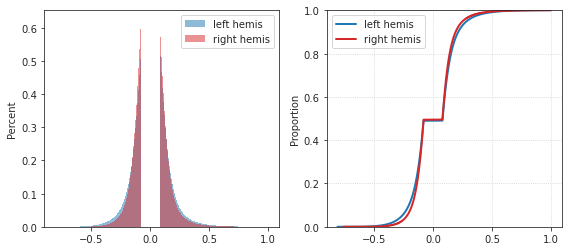

In [13]:
key = 'SLC01_ses-1_run-5'

Text(0.5, 1.03, 'SLC01_ses-1_run-5')

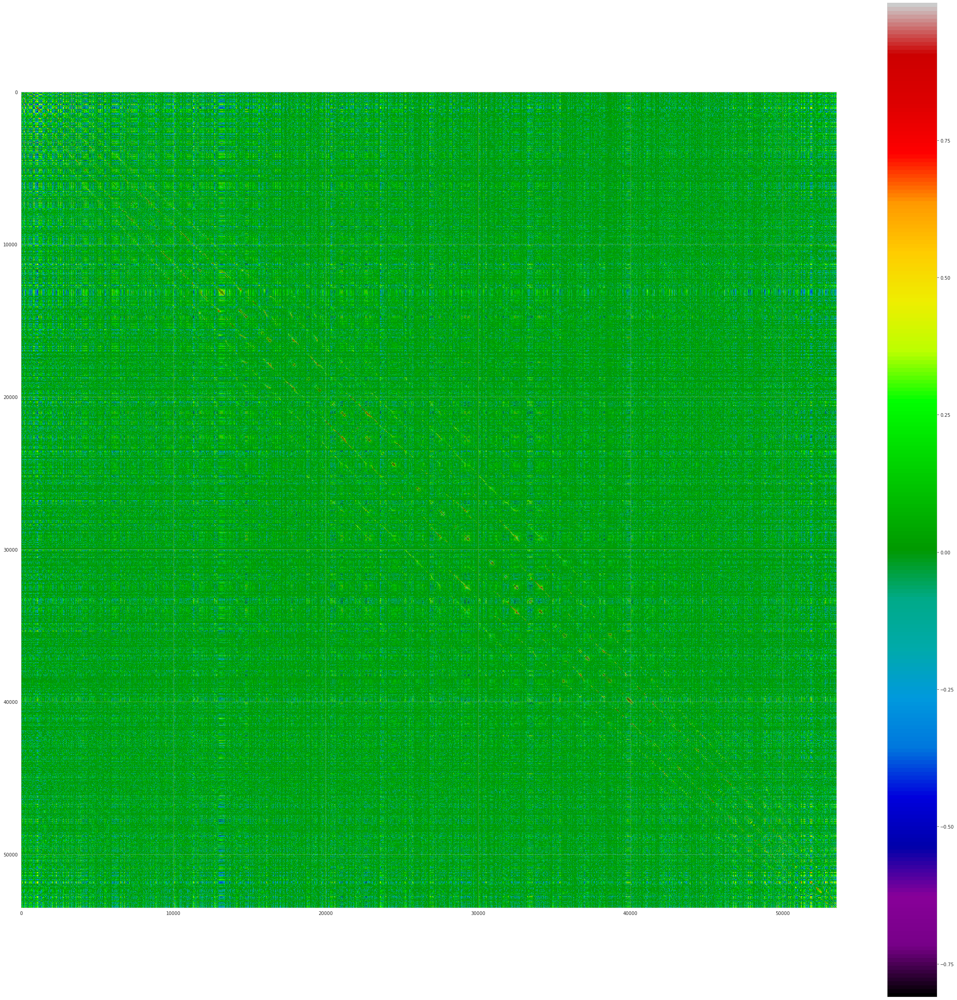

In [27]:
plt.figure(figsize=(40, 40))
plt.imshow(a, cmap='nipy_spectral')
plt.colorbar()
plt.show()

In [33]:
from analysis.hierarchical import sp_hier

In [37]:
d = (1 - a) / 2
np.fill_diagonal(d, 0.)

In [ ]:
%%time

linkage = sp_hier.linkage(
    sp_dist.squareform(d),
    method='ward',
    metric='correlation',
    optimal_ordering=True,
)

In [ ]:
%%time

hier_result = get_clust_graph(
    linkage_mat=linkage,
    labels=list(id2vox),
    num_clusters=5,
)